In [1]:
# from google.colab import drive
# drive.mount('/content/drive')

In [2]:
from tqdm.auto import tqdm
from sklearn.cluster import KMeans, DBSCAN
from sklearn.metrics.pairwise import euclidean_distances
from matplotlib.ticker import MaxNLocator
from sklearn.manifold import TSNE
from torchvision import transforms
from torch.utils.data import DataLoader
from torchvision.datasets import ImageFolder
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [3]:
#not_pretrained = np.load('/content/drive/My Drive/hateful_memes/embeddings/resnet18_not_pretrained_epoch=139.npy')
#pretrained = np.load('/content/drive/My Drive/hateful_memes/embeddings/resnet18_pretrained_epoch=50.npy')
#resnet = np.load('/content/drive/My Drive/hateful_memes/embeddings/resnet18.npy')

not_pretrained = np.load('resnet18_not_pretrained_epoch=139.npy')
pretrained = np.load('resnet18_pretrained_epoch=50.npy')
resnet = np.load('resnet18.npy')
softmax_resnet = np.load('softmax_resnet.npy')

embs = [not_pretrained, pretrained, resnet, softmax_resnet]
embs_name = ['BYOL with not pretrained resnet', 'BYOL with pretrained resnet', 'Pretrained resnet',
            'Pretrained resnet with softmax']

data_transform = transforms.Compose([
    transforms.Resize(256),
    transforms.CenterCrop(224),
    transforms.ToTensor(),
    transforms.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225])])

image_folder = ImageFolder('~/Desktop/data/train/', transform=data_transform)
DATALOADER_FROM_IMG_FODLER = DataLoader(image_folder, batch_size=32)

In [4]:
def plot_tsne(embs, labels, model_name, metric='euclidean'):
    tsne = TSNE(metric=metric)
    X = tsne.fit_transform(embs)
    plt.title('T-SNE for {}'.format(model_name), fontsize=20)
    sns.scatterplot(X[:,0], X[:,1], hue=labels,
                    legend='full', palette = sns.color_palette("hls", len(np.unique(labels))))
    
def plot_samples(embs, labels, n=5):
    clusters, counts = np.unique(labels[labels != -1], return_counts=True)
    idx = np.argsort(counts)
    sorted_clusters = clusters[idx]
    min_cluster = sorted_clusters[0]
    rand_cluster = sorted_clusters[len(clusters) // 2]
    max_cluster = sorted_clusters[-1]
    num_cluster = [min_cluster, rand_cluster, max_cluster]
    
    fig = plt.figure(figsize=(40, 30)) 
    for i, cl in enumerate(num_cluster):
        cluster_imgs_idx = np.where(labels == cl)[0]

        if len(cluster_imgs_idx) >= n:
            n_cluster_imgs = np.random.choice(cluster_imgs_idx, size=n, replace=False)

            for j, idx in enumerate(n_cluster_imgs):
                img_path, _ = DATALOADER_FROM_IMG_FODLER.dataset.samples[idx]
                plt.subplot(3, n, i * n + j + 1)
                plt.title('Cluster {}'.format(cl), fontsize=40)
                img = plt.imread(img_path)
                plt.imshow(img)
    plt.show()

## k-means

In [6]:
def k_means(embeddings, n_clusters, return_labels=True):
    kmeans = KMeans(n_clusters=n_clusters)
    
    if return_labels:
        labels = kmeans.fit_predict(embeddings)
        return labels
    
    distances = kmeans.fit_transform(embeddings)
    closest_distances = np.min(distances, axis=1)
    return np.mean(closest_distances)

def plot_kmeans_params(embeddings, n_clusters_list, title=''):
    mean_distances = []
    for n_clusters in tqdm(n_clusters_list):
        dist = k_means(embeddings, n_clusters, return_labels=False) 
        mean_distances.append(dist)
    plt.plot(n_clusters_list, mean_distances, label=title)

### n_clusters VS avg dist from centroid

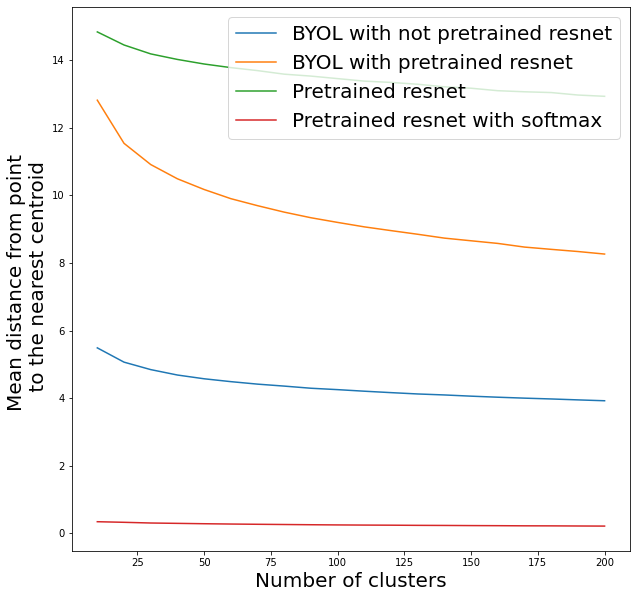

In [5]:
n_clusters = np.arange(10, 201, 10)

plt.figure(figsize=(10, 10))
for i, emb in enumerate(embs[:-1]):
    plot_kmeans_params(emb, n_clusters, embs_name[i]) 
plt.legend(loc=1, fontsize=20)
plt.xlabel('Number of clusters', fontsize=20)
plt.ylabel('Mean distance from point \n to the nearest centroid', fontsize=20)
plt.show()

### T-SNE and sampling

In [5]:
n_clusters = [5, 10, 20]

#### resnet18 not pretrained

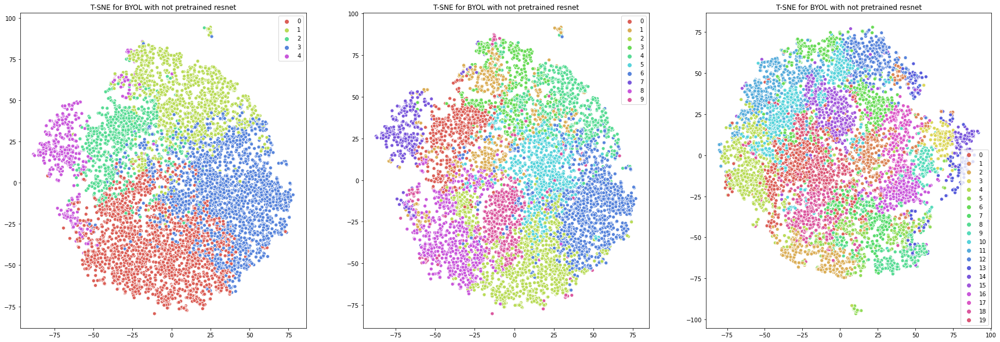

In [5]:
plt.figure(figsize=(30, 10))
for i, cl in enumerate(n_clusters):
    plt.subplot(1, 3, i + 1)
    labels = k_means(not_pretrained, cl)
    plot_tsne(not_pretrained, labels, embs_name[0])

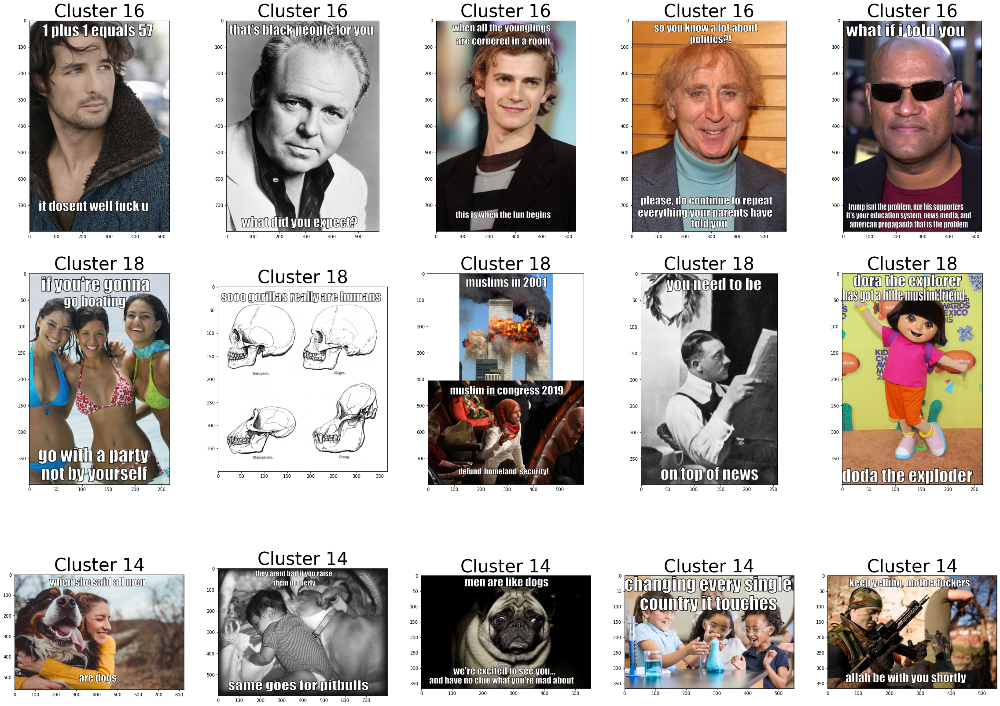

In [84]:
n_clusters = 20
labels = k_means(not_pretrained, n_clusters)
plot_samples(not_pretrained, labels)

#### resnet18 pretrained

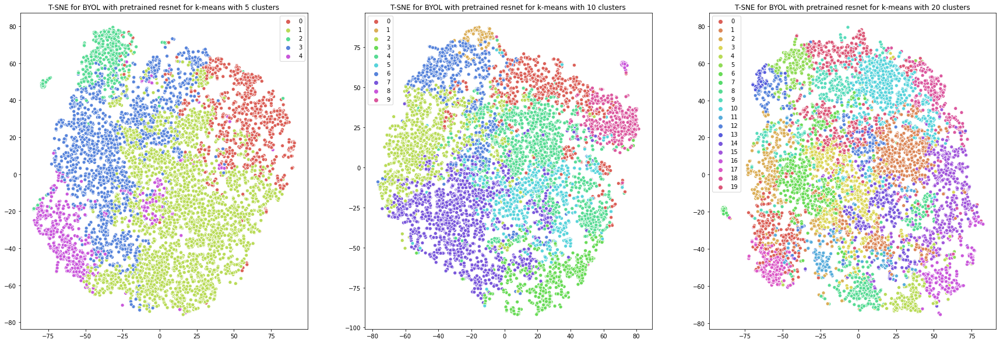

In [7]:
plt.figure(figsize=(30, 10))
for i, cl in enumerate(n_clusters):
    plt.subplot(1, 3, i + 1)
    labels = k_means(pretrained, cl)
    plot_tsne(pretrained, labels, embs_name[1] + ' for k-means with {} clusters'.format(cl))

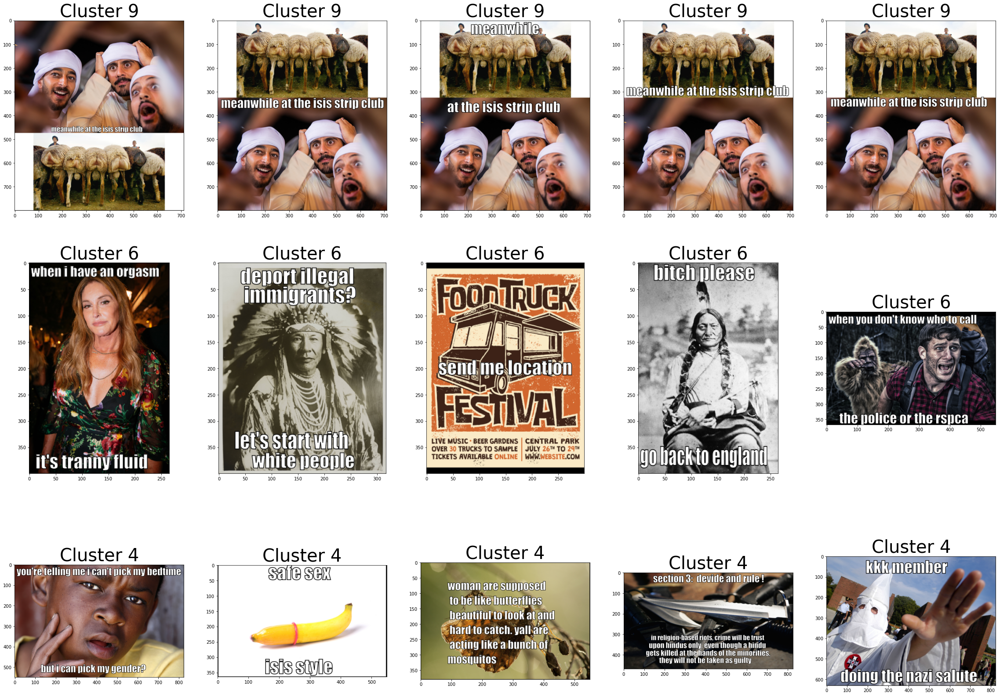

In [77]:
n_clusters = 10
labels = k_means(pretrained, n_clusters)
plot_samples(pretrained, labels)

#### resnet18

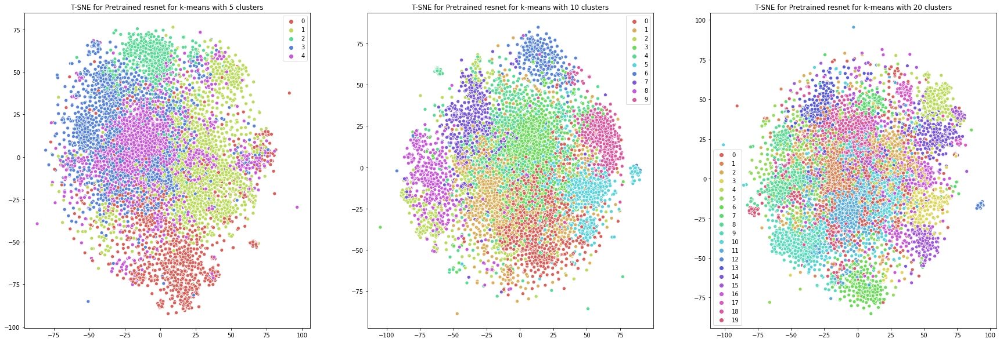

In [8]:
plt.figure(figsize=(30, 10))
for i, cl in enumerate(n_clusters):
    plt.subplot(1, 3, i + 1)
    labels = k_means(resnet, cl)
    plot_tsne(resnet, labels, embs_name[2] + ' for k-means with {} clusters'.format(cl))

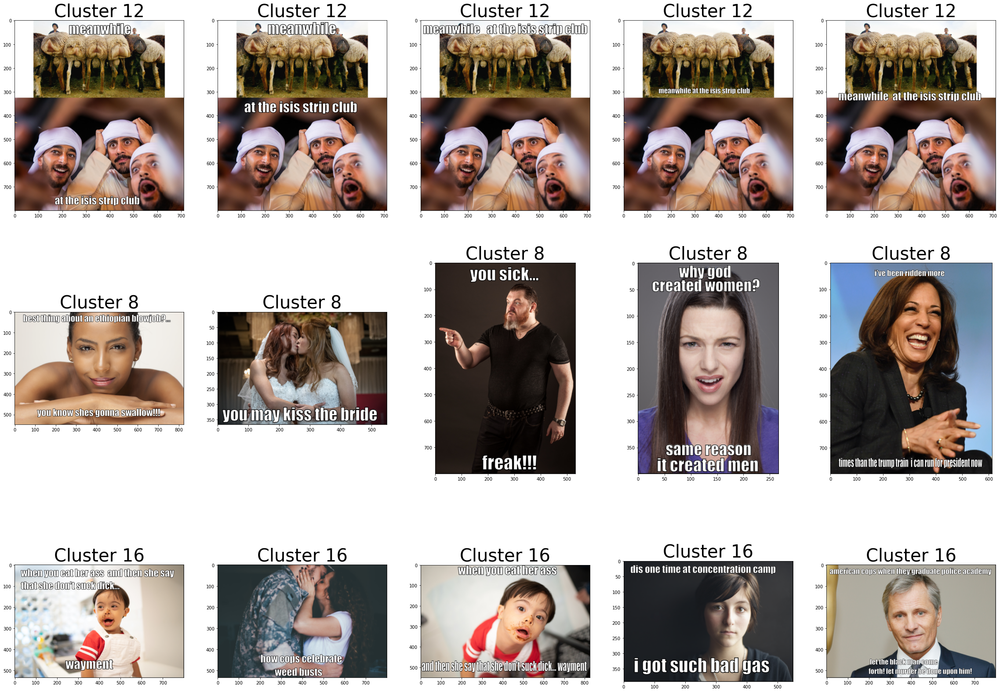

In [83]:
n_clusters = 20
labels = k_means(resnet, n_clusters)
plot_samples(resnet, labels)

## DBSCAN

In [5]:
def dbscan(embeddings, eps, min_samples, metric, return_labels=True):
    dbscan = DBSCAN(eps=eps, min_samples=min_samples, metric=metric)
    dbscan.fit(embeddings)
    labels = dbscan.labels_
    if return_labels:
        return labels
    
    n_clusters = len(np.unique(labels)) - 1
    n_noisy = len(np.where(labels == -1)[0])
    return n_clusters, n_noisy
    
def get_dist_list(X, metric, n=5):
    if metric == 'euclidean':
        dist_matr = euclidean_distances(X)
        min_dist = np.min(dist_matr[dist_matr != 0])
        max_dist = np.max(dist_matr) // 2
    else:
        min_dist, max_dist = 1e-5, 1
    step = (max_dist - min_dist) / n
    return np.arange(min_dist, max_dist, step)

In [6]:
def plot_dbscan_params(embeddings, eps_list, min_samples, plot_1, plot_2, metric='euclidean'):
    params = []
    for eps in tqdm(eps_list):
        p = dbscan(embeddings, eps, min_samples, metric=metric, return_labels=False)
        params.append(p)
    clusters_eps, noisy_eps = list(zip(*params))
    plot_1.plot(eps_list, np.array(clusters_eps), label=str(min_samples) + ' neighbors')
    plot_2.plot(eps_list, np.array(noisy_eps), label=str(min_samples) + ' neighbors')


def dbscan_eps_with_samples(embeddings, min_samples_list, metric='euclidean'):
    fig = plt.figure(figsize=(20, 10))
    ax1 = fig.add_subplot(121)
    ax2 = fig.add_subplot(122)
    
    eps_list = get_dist_list(embeddings, metric)
    for s in min_samples_list:
        plot_dbscan_params(embeddings, eps_list, s, ax1, ax2, metric)

    ax1.set_xlabel('Maximum distance between neighbors', fontsize=15)
    ax2.set_xlabel('Maximum distance between neighbors', fontsize=15)
    ax1.set_ylabel('Number of clusters', fontsize=15)
    ax2.set_ylabel('Number of noise samples', fontsize=15)
    ax1.legend(fontsize=15)
    ax2.legend(fontsize=15)
    plt.show()
    
    
# def plot_dbscan_samples(embeddings, eps, min_samples_list, model_name):         
#     params = []
#     for samples in tqdm(min_samples_list):
#         p = dbscan(embeddings, eps, samples, return_labels=False)
#         params_samples.append(p)
#     clusters_samples, noisy_samples = list(zip(*params))
#     x_data = min_samples_list
#     y_data = [np.array(clusters_samples), np.array(noisy_samples)]
#     x_title = 'Number of neighbors'
        
#     y_titles = ['Number of clusters', 'Number of noise samples']
#     fig = plt.figure(figsize=(20, 10))
#     for i, x in enumerate(y_data):
#         plt.subplot(1, 2, i + 1)
#         plt.title('Num neighbors for ' + model_name, fontsize=15)
#         ax = fig.gca()
#         ax.yaxis.set_major_locator(MaxNLocator(integer=True))
#         plt.xlabel(x_title, fontsize=15)
#         plt.ylabel(y_titles[i], fontsize=15)
#         plt.plot(x_data, y_data[i])
#     plt.show()

### distance VS n_clusters & n_noisy_samples 

In [7]:
n_neighbors = [5, 10, 20]

#### resnet18 not pretrained

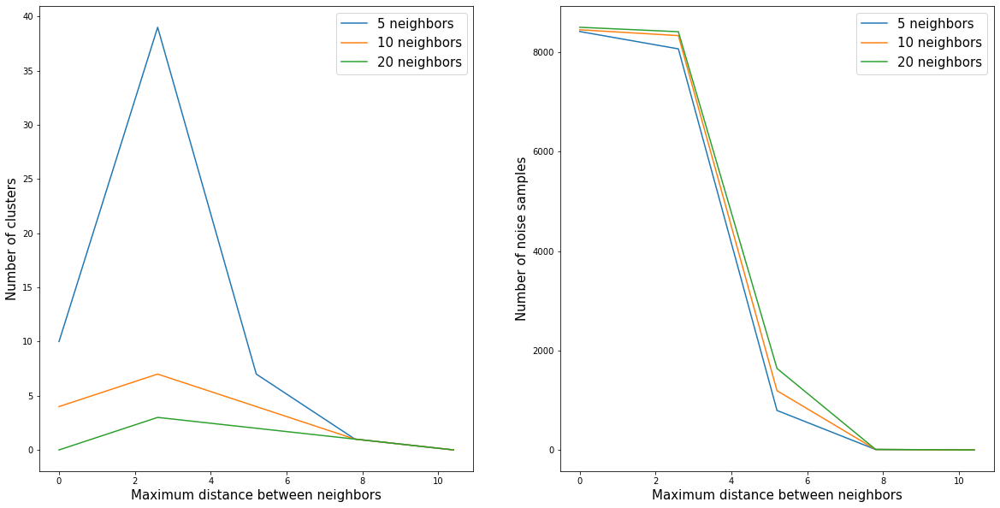

In [40]:
dbscan_eps_with_samples(not_pretrained, n_neighbors)

#### resnet18 pretrained

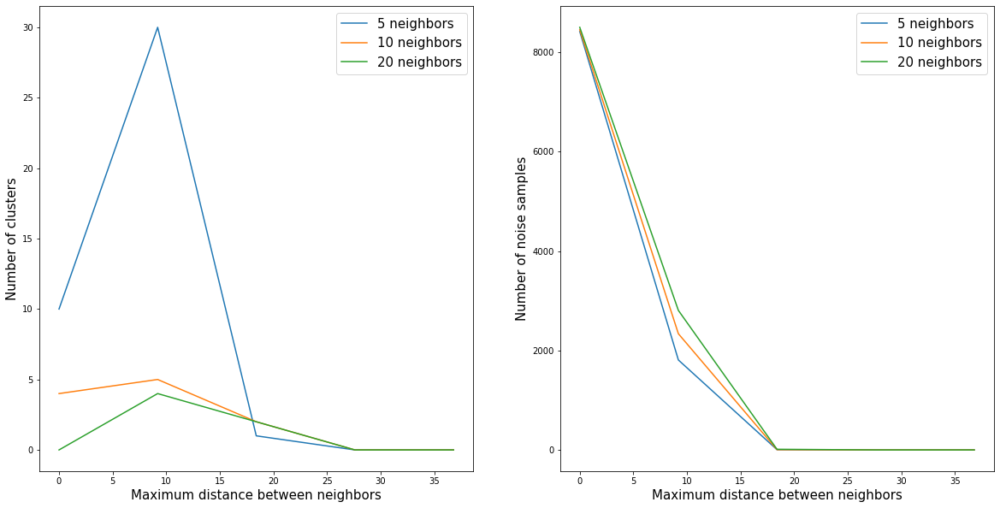

In [41]:
dbscan_eps_with_samples(pretrained, n_neighbors)

#### resnet18

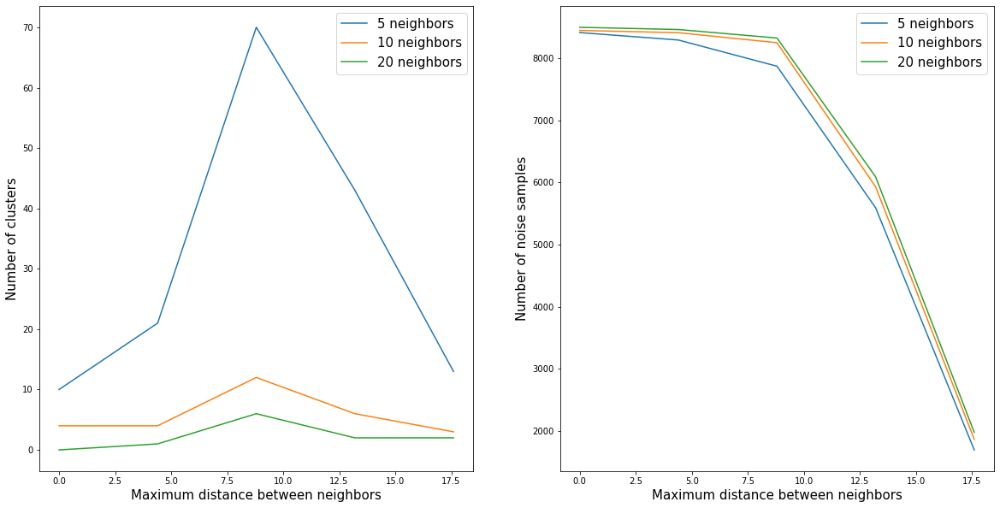

In [18]:
dbscan_eps_with_samples(resnet, n_neighbors)

#### resnet18 with softmax

In [8]:
# def compute_chi_squared_dist(X):
#     num = (X - X[:, None]) ** 2
#     den =  X + X[:, None]
#     res = np.sum(num / den, axis=-1) / 2
#     return res

def chi_squared_dist(a, b):
    return np.sum((a - b) ** 2 / (a + b)) / 2

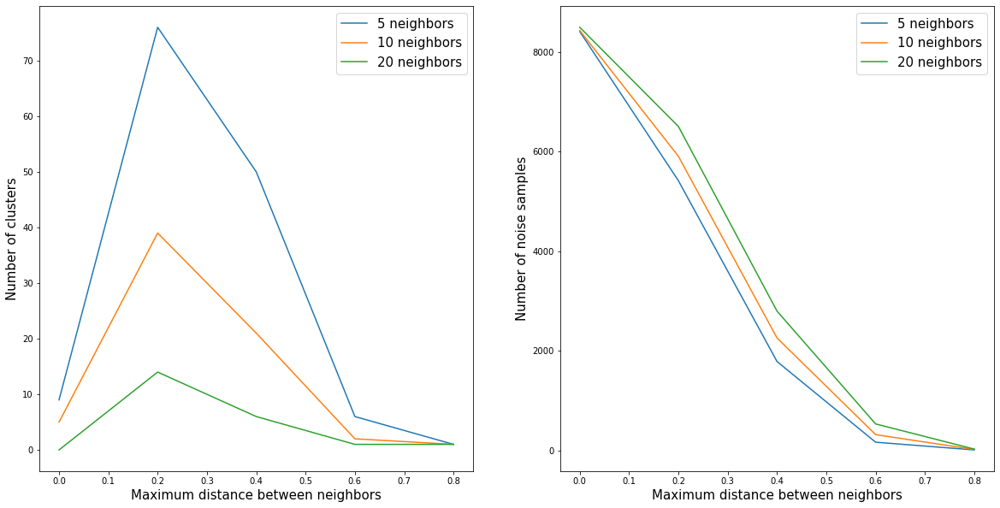

In [9]:
dbscan_eps_with_samples(softmax_resnet, n_neighbors,  metric=chi_squared_dist)

### T-SNE and sampling

#### resnet18 not pretrained

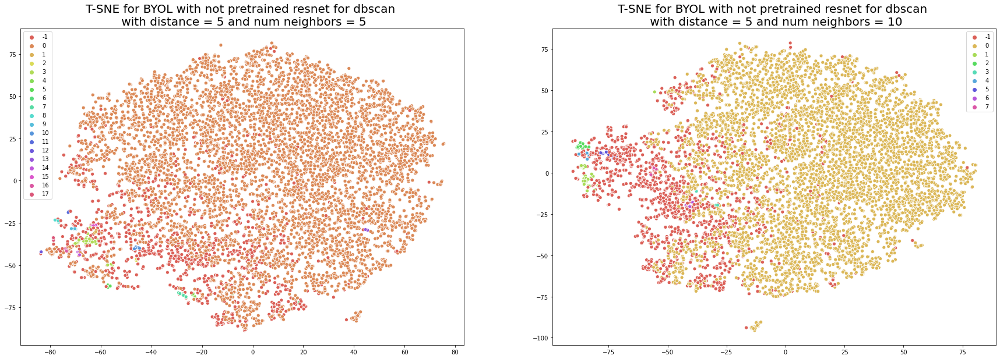

In [16]:
eps = 5
min_samples = [5, 10]

plt.figure(figsize=(30, 10))
for i, s in enumerate(min_samples):
    plt.subplot(1, 2, i + 1)
    labels = dbscan(not_pretrained, eps, s)
    plot_tsne(not_pretrained, labels, embs_name[0] + ' for dbscan \n with distance = {} and num neighbors = {}'.format(eps, s))

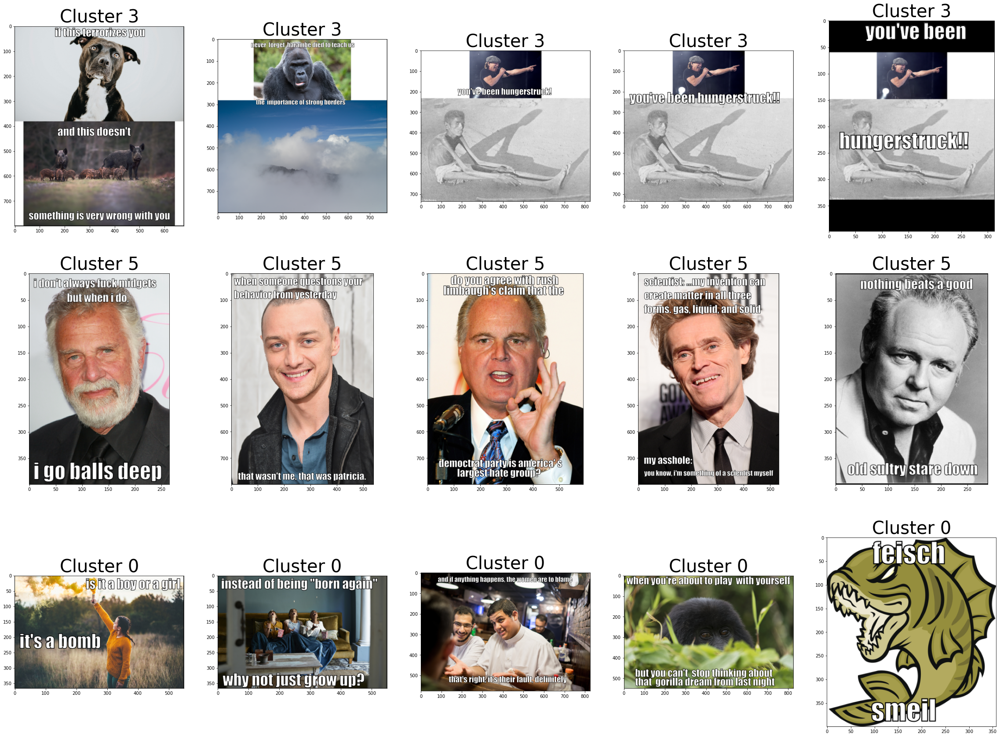

In [101]:
labels = dbscan(not_pretrained, eps=5, min_samples=10)
plot_samples(not_pretrained, labels)

#### resnet18 pretrained

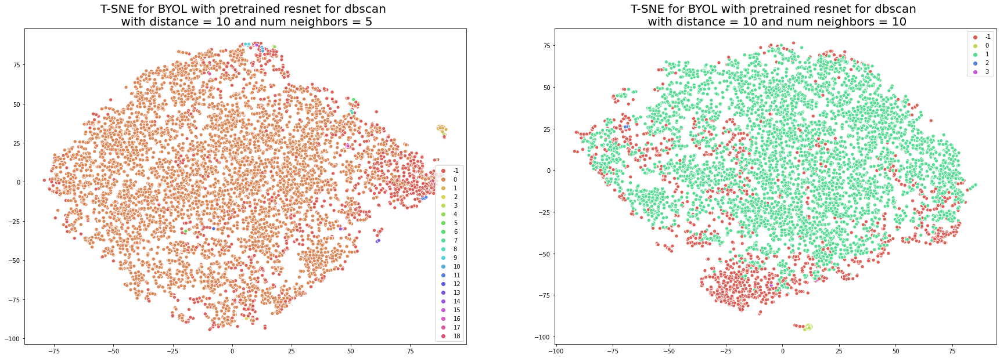

In [17]:
eps = 10
min_samples = [5, 10]

plt.figure(figsize=(30, 10))
for i, s in enumerate(min_samples):
    plt.subplot(1, 2, i + 1)
    labels = dbscan(pretrained, eps, s)
    plot_tsne(pretrained, labels, embs_name[1] + ' for dbscan \n with distance = {} and num neighbors = {}'.format(eps, s))

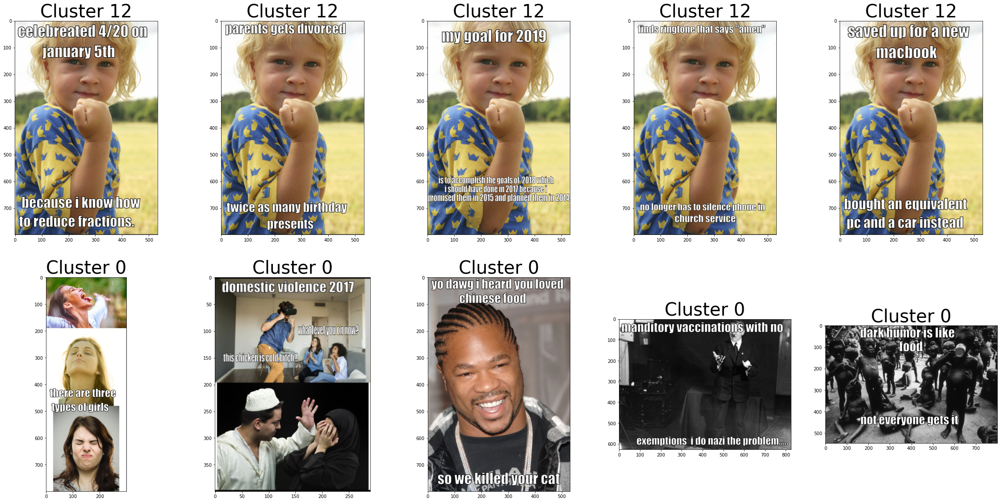

In [102]:
labels = dbscan(pretrained, eps=10, min_samples=5)
plot_samples(pretrained, labels)

#### resnet18

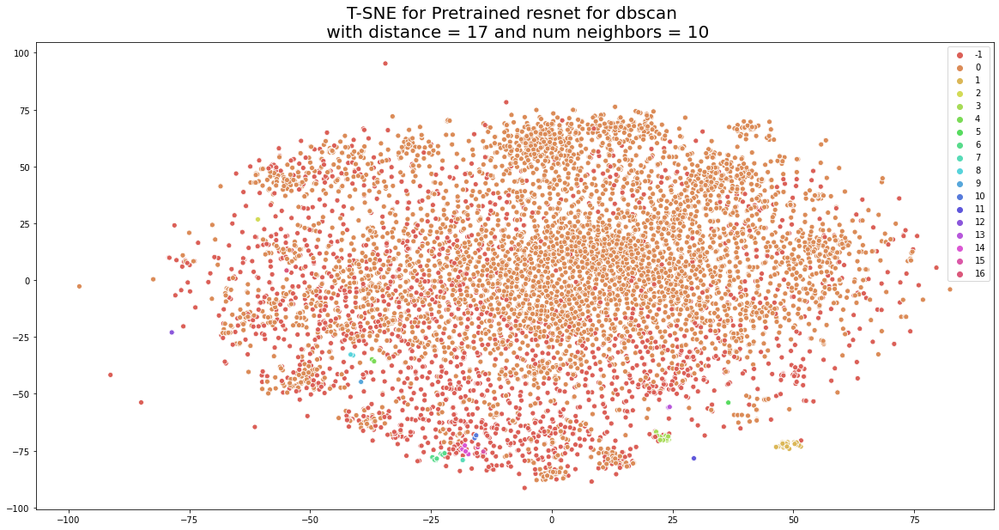

In [82]:
eps = 17
min_samples = 5

plt.figure(figsize=(20, 10))
labels = dbscan(resnet, eps, min_samples)
plot_tsne(resnet, labels, embs_name[2] + ' for dbscan \n with distance = {} and num neighbors = {}'.format(eps, s))

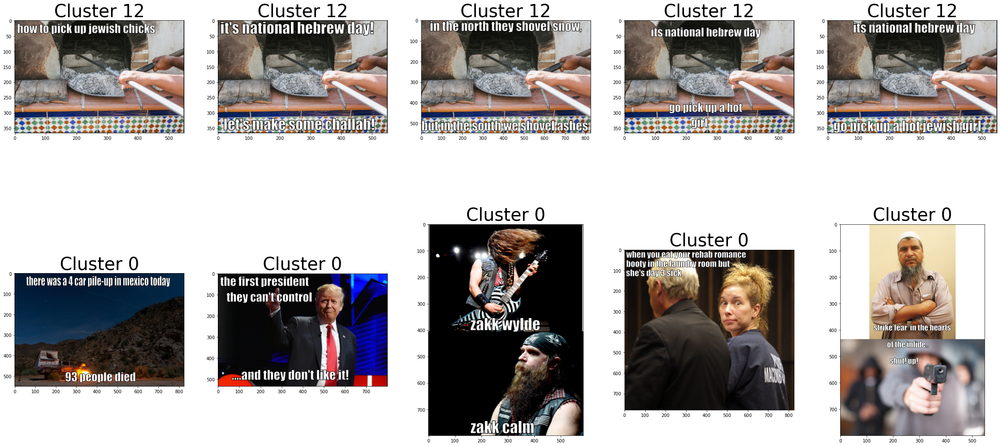

In [107]:
labels = dbscan(resnet, eps=17, min_samples=5)
plot_samples(resnet, labels)

#### resnet18 with softmax

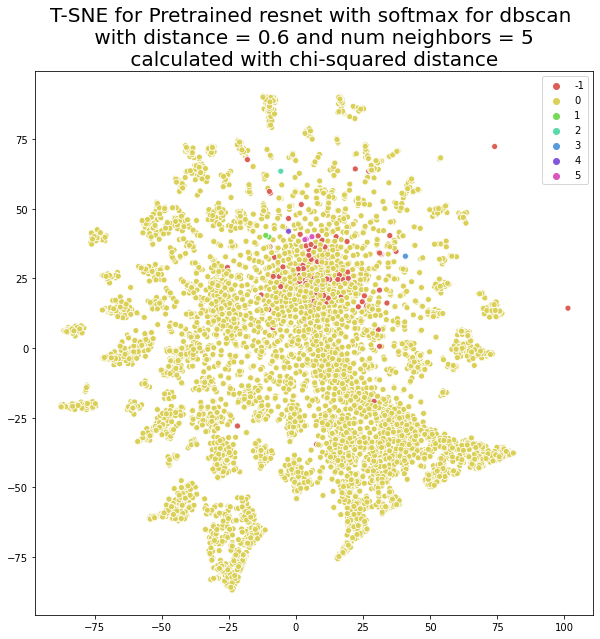

In [10]:
eps = 0.6
min_samples = 5

plt.figure(figsize=(10, 10))
labels = dbscan(softmax_resnet, eps, min_samples, metric=chi_squared_dist)
plot_tsne(softmax_resnet, labels, embs_name[3] + ' for dbscan \n with distance = {} and num neighbors = {} \n calculated with chi-squared distance '.format(eps, min_samples))

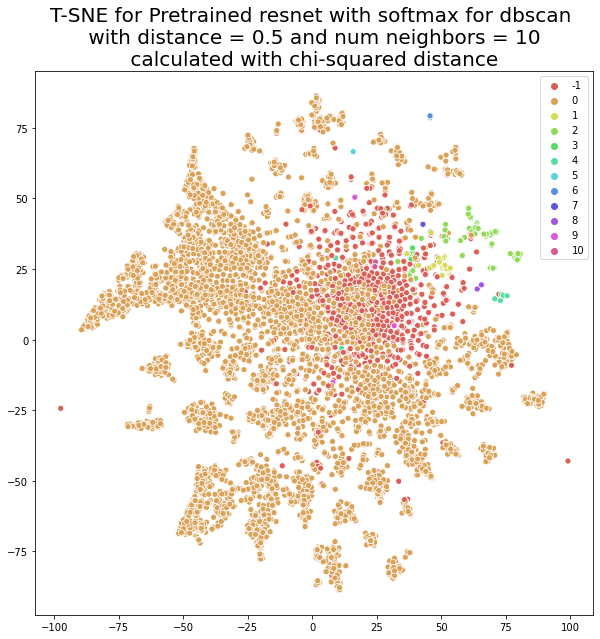

In [11]:
eps = 0.5
min_samples = 10

plt.figure(figsize=(10, 10))
labels = dbscan(softmax_resnet, eps, min_samples, metric=chi_squared_dist)
plot_tsne(softmax_resnet, labels, embs_name[3] + ' for dbscan \n with distance = {} and num neighbors = {} \n calculated with chi-squared distance '.format(eps, min_samples))